# CLIP (Constrasitive Language and Image Pre-trained model) test

In [2]:
# https://github.com/openai/CLIP

In [1]:
#Check CUDA and torch version
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)
""""
if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

#!pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex
"""
import numpy as np
import torch
import os

print("Torch version:", torch.__version__)
#os.kill(os.getpid(), 9)


CUDA version: 11.0
Torch version: 1.7.1+cu110


In [18]:
# Check available model
clip.available_models()

['RN50', 'RN101', 'RN50x4', 'RN50x16', 'ViT-B/32', 'ViT-B/16']

## Improve accuracy with Image Embedding + Text Embedding

In [ ]:
# Enroll new product{class:description}
product_descriptions = {

In [ ]:
"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mMilk":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanut": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk"}

print(list(product_descriptions.keys()))
print(list(product_descriptions.values()))

%matplotlib inline

import torch
import clip
from PIL import Image
import glob
import matplotlib.pyplot as plt

def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/16", device=device)

correct = []

#define our target classificaitons, you can should experiment with these strings of text as you see fit, though, make sure they are in the same order as your class names above
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)
y_true = []
y_pred = []
for cls in class_names:
    class_correct = []
    test_imgs = glob.glob('./sb_22samples_fit/valid/' + cls + '/*.jpg')

    for img in test_imgs:
        image = transform(Image.open(img)).unsqueeze(0).to(device)
        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)

            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            pred = class_names[argmax(list(probs)[0])]
            im = Image.open(img)
            plt.figure(figsize=(5,5))
            plt.imshow(im)
            plt.show()

            print(cls, ": "," predicted as ", pred, max(list(probs)[0]) )
            if pred == cls:
                correct.append(1)
                class_correct.append(1)
            else:
                correct.append(0)
                class_correct.append(0)
            y_true.append(cls)
            y_pred.append(pred)
    
    if len(class_correct) !=0:
        print('\naccuracy on class ' + cls + ' is :' + str(sum(class_correct)/len(class_correct)))
    else: 
        print('\nno picture are found for ' + cls)
print('\naccuracy on all is : ' + str(sum(correct)/len(correct)))
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_true, y_pred, labels = class_names)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.show()

['7874222803-sugar', '4157005670-almondmilk', '8491201426-HoneyBunch', '8113118392-tussin', '8113106123-tussin_max', '7874212406-sweetner', '1015803449-Cleanser', '4400004575-RitzCracker', '3600041777-Wipes', '41331112406-Beans', '1411391254-Pistachios', '8616220043-water', '7203002209-littleBite', '4000055113-m&mMilk', '1800012323-miniBiscuits', '4000051121-m&mPeanut', '3528244925-toyPenguin', '1920089962-SurfaceCleaner', '1600017819-berryCereal', '5000015991-evaporatedMilk', '7314115315-oreoPocky', '7232075003-pandaCookie', '787423717-taco', '4300020056-limeJello', '4300020053-cherryJello', '1370037299-Ziplock', '4288742634-dishwasherCleaner', '000000-lemon', '6416410193-BlueBerryBun', '84576204143-galaApple', '800016643095-Chips', '9413844-FujiApple']
['Great Value Pure Granulated Sugar 4 lb', 'Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz', 'Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce', '

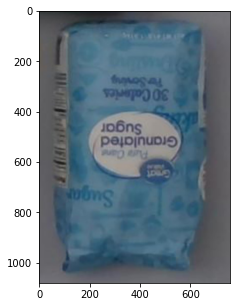

7874222803-sugar :   predicted as unrecongized -  1800012323-miniBiscuits 0.4932


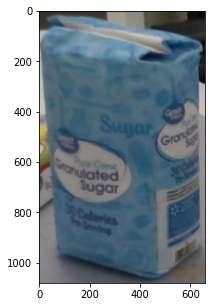

7874222803-sugar :   predicted as  7874222803-sugar 0.9854


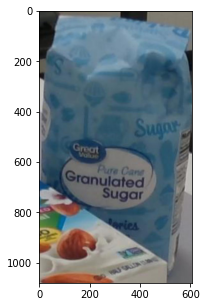

7874222803-sugar :   predicted as  7874222803-sugar 1.0


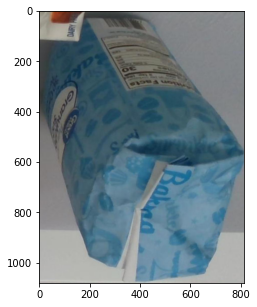

7874222803-sugar :   predicted as unrecongized -  6416410193-BlueBerryBun 0.2886


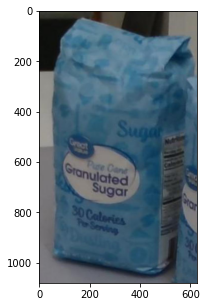

7874222803-sugar :   predicted as  7874222803-sugar 0.998


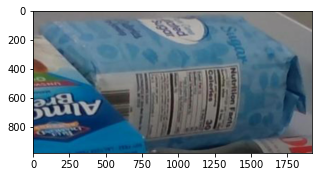

7874222803-sugar :   predicted as  1800012323-miniBiscuits 0.8057


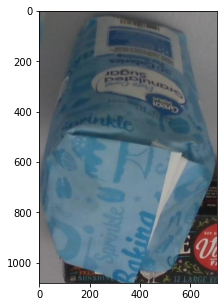

7874222803-sugar :   predicted as unrecongized -  3600041777-Wipes 0.4639


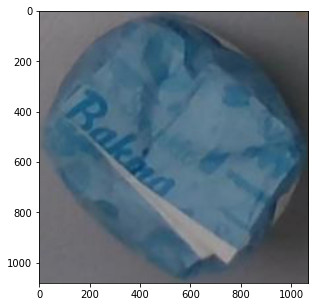

7874222803-sugar :   predicted as unrecongized -  6416410193-BlueBerryBun 0.52


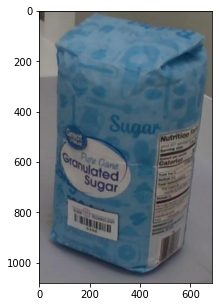

7874222803-sugar :   predicted as  7874222803-sugar 0.9995


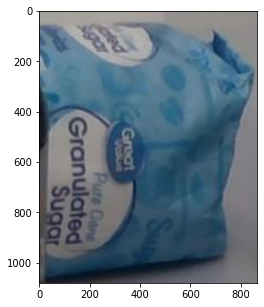

7874222803-sugar :   predicted as  7874222803-sugar 0.973


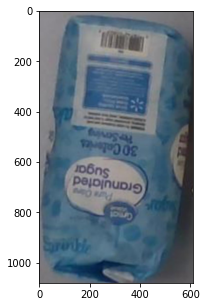

7874222803-sugar :   predicted as unrecongized -  1800012323-miniBiscuits 0.4954


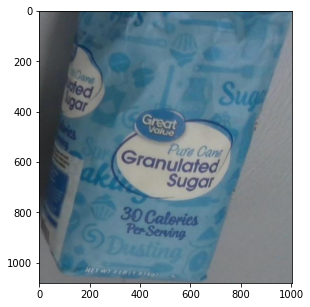

7874222803-sugar :   predicted as  7874222803-sugar 0.999


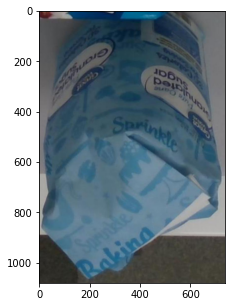

7874222803-sugar :   predicted as unrecongized -  1800012323-miniBiscuits 0.524


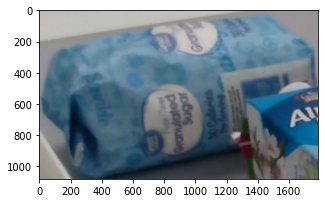

7874222803-sugar :   predicted as unrecongized -  1800012323-miniBiscuits 0.5713


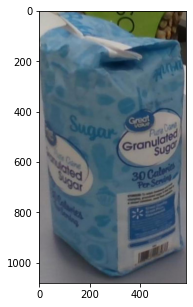

7874222803-sugar :   predicted as  7874222803-sugar 0.9995


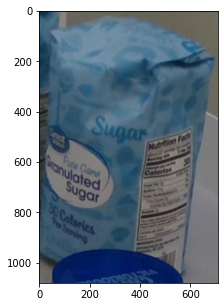

7874222803-sugar :   predicted as  7874222803-sugar 0.9834


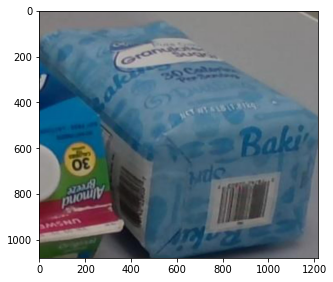

7874222803-sugar :   predicted as unrecongized -  5000015991-evaporatedMilk 0.578

accuracy on class 7874222803-sugar is :0.8888888888888888

recongized:  9    unrecognized:  8


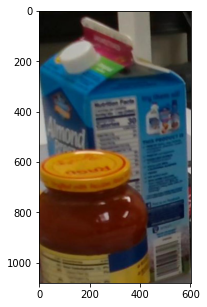

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.937


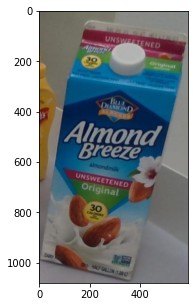

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


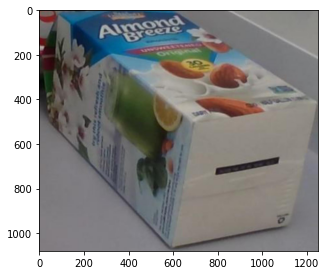

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9976


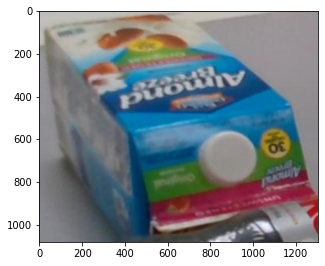

4157005670-almondmilk :   predicted as unrecongized -  5000015991-evaporatedMilk 0.7173


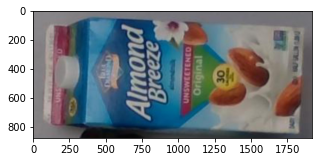

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9937


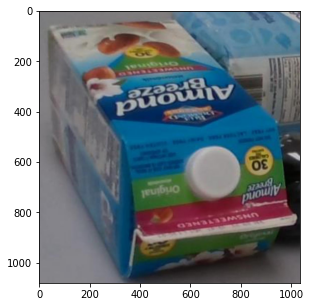

4157005670-almondmilk :   predicted as unrecongized -  5000015991-evaporatedMilk 0.6157


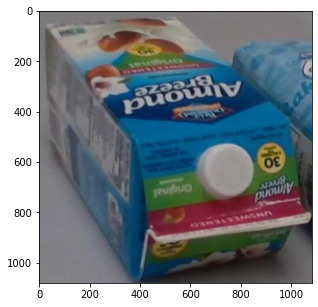

4157005670-almondmilk :   predicted as unrecongized -  1800012323-miniBiscuits 0.3635


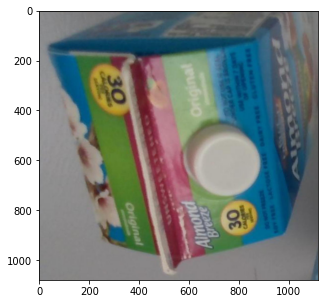

4157005670-almondmilk :   predicted as unrecongized -  5000015991-evaporatedMilk 0.669


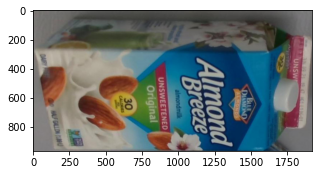

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


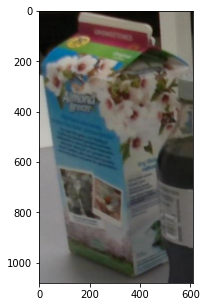

4157005670-almondmilk :   predicted as unrecongized -  4157005670-almondmilk 0.67


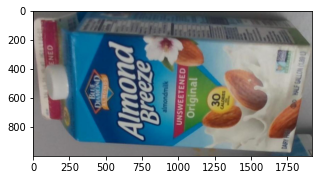

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


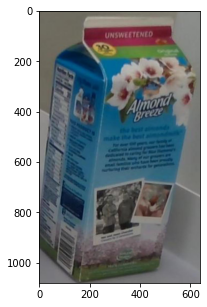

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


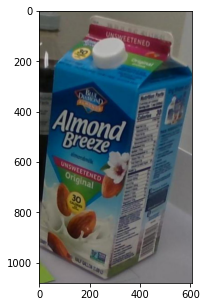

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


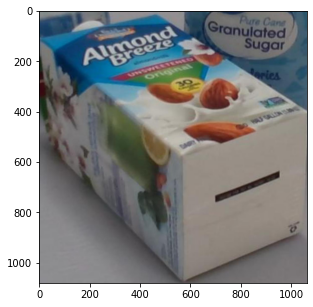

4157005670-almondmilk :   predicted as unrecongized -  4157005670-almondmilk 0.643


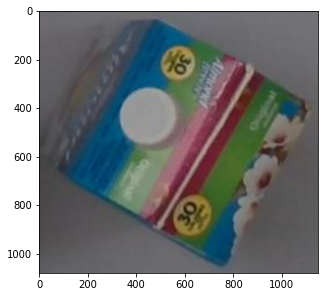

4157005670-almondmilk :   predicted as unrecongized -  7203002209-littleBite 0.4395


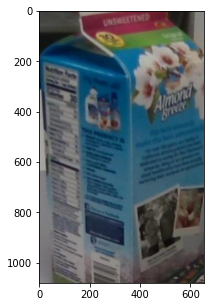

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9966


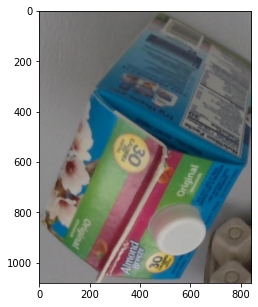

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.907

accuracy on class 4157005670-almondmilk is :0.9

recongized:  10    unrecognized:  7

no picture are found for 8491201426-HoneyBunch

no picture are found for 8113118392-tussin

no picture are found for 8113106123-tussin_max


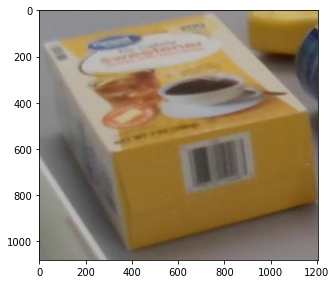

7874212406-sweetner :   predicted as unrecongized -  7203002209-littleBite 0.441


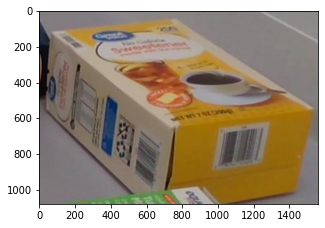

7874212406-sweetner :   predicted as unrecongized -  5000015991-evaporatedMilk 0.2534


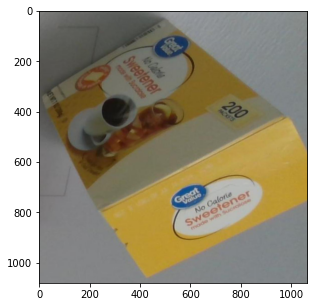

7874212406-sweetner :   predicted as  7874212406-sweetner 0.9785


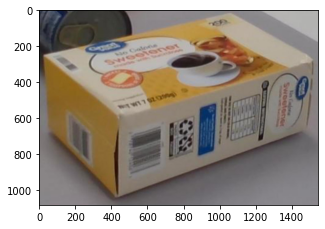

7874212406-sweetner :   predicted as unrecongized -  7874212406-sweetner 0.3826


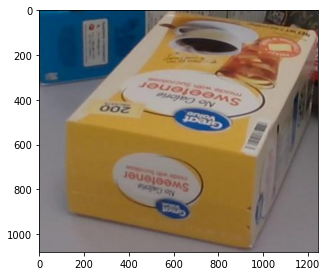

7874212406-sweetner :   predicted as unrecongized -  1800012323-miniBiscuits 0.577


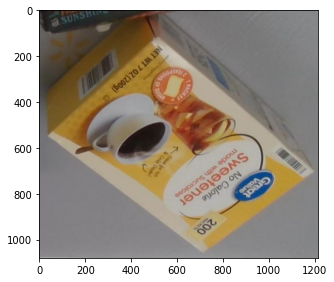

7874212406-sweetner :   predicted as unrecongized -  7203002209-littleBite 0.367


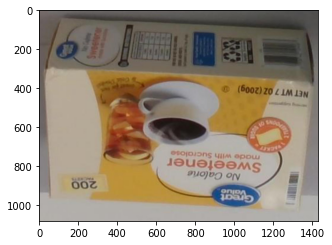

7874212406-sweetner :   predicted as unrecongized -  7874212406-sweetner 0.4094


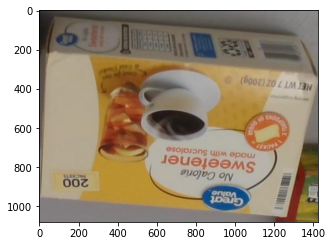

7874212406-sweetner :   predicted as unrecongized -  1800012323-miniBiscuits 0.2915


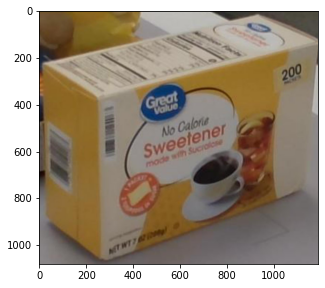

7874212406-sweetner :   predicted as  7874212406-sweetner 0.996


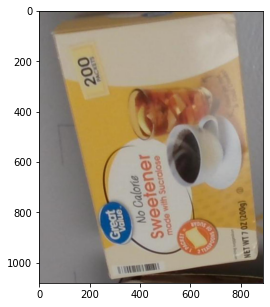

7874212406-sweetner :   predicted as  7874212406-sweetner 1.0


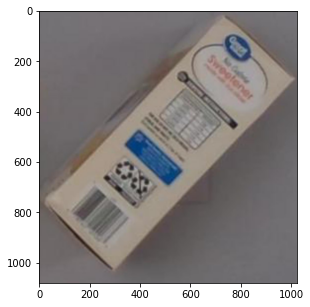

7874212406-sweetner :   predicted as unrecongized -  1370037299-Ziplock 0.2642


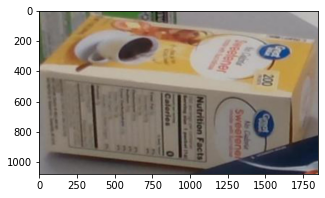

7874212406-sweetner :   predicted as  5000015991-evaporatedMilk 0.7817


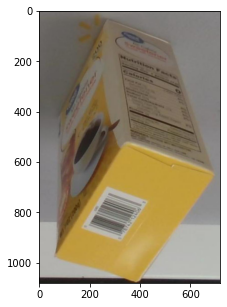

7874212406-sweetner :   predicted as unrecongized -  5000015991-evaporatedMilk 0.5205


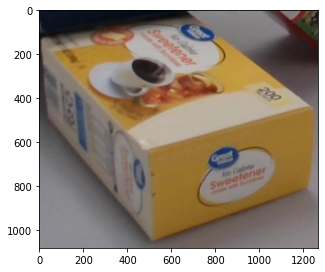

7874212406-sweetner :   predicted as unrecongized -  1800012323-miniBiscuits 0.481


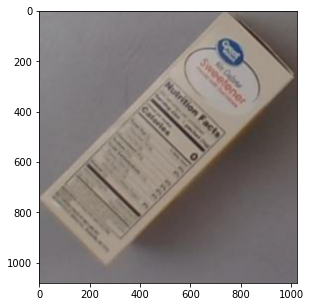

7874212406-sweetner :   predicted as  5000015991-evaporatedMilk 0.8477


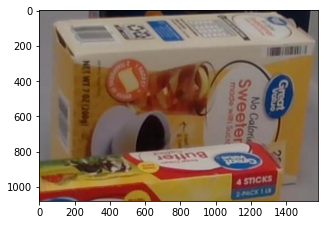

7874212406-sweetner :   predicted as unrecongized -  1800012323-miniBiscuits 0.4346


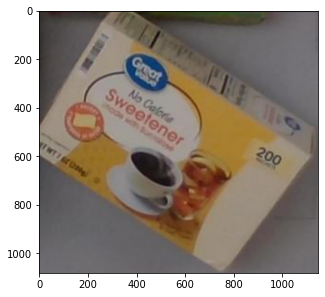

7874212406-sweetner :   predicted as  7874212406-sweetner 0.9995


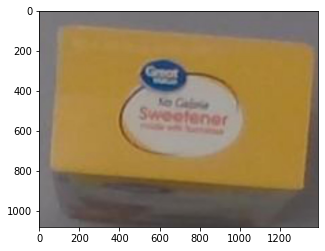

7874212406-sweetner :   predicted as  7874212406-sweetner 0.9766

accuracy on class 7874212406-sweetner is :0.7142857142857143

recongized:  7    unrecognized:  11


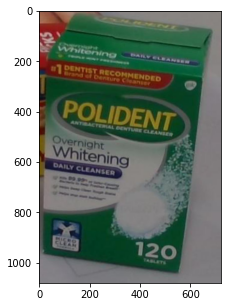

1015803449-Cleanser :   predicted as  1015803449-Cleanser 1.0


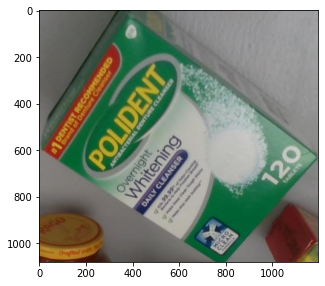

1015803449-Cleanser :   predicted as  1015803449-Cleanser 0.9795


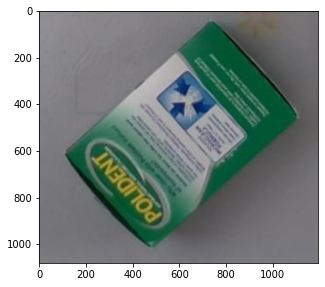

1015803449-Cleanser :   predicted as  8113118392-tussin 0.804


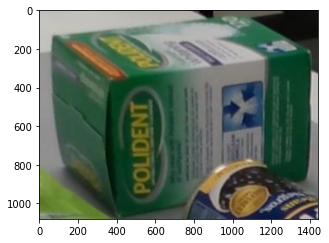

1015803449-Cleanser :   predicted as  1015803449-Cleanser 0.9634


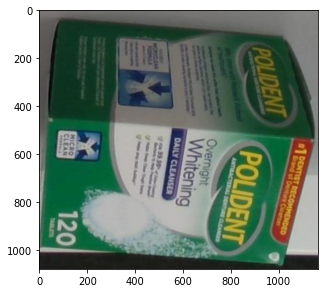

1015803449-Cleanser :   predicted as  1015803449-Cleanser 0.999


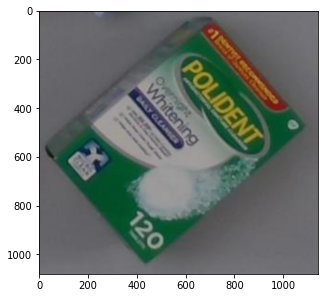

1015803449-Cleanser :   predicted as  1015803449-Cleanser 0.993


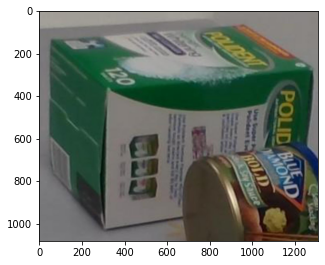

1015803449-Cleanser :   predicted as unrecongized -  4288742634-dishwasherCleaner 0.707


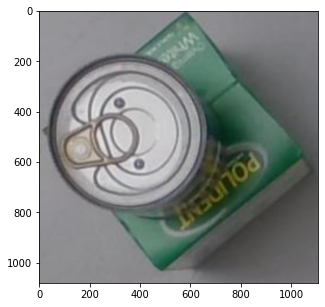

1015803449-Cleanser :   predicted as unrecongized -  5000015991-evaporatedMilk 0.546


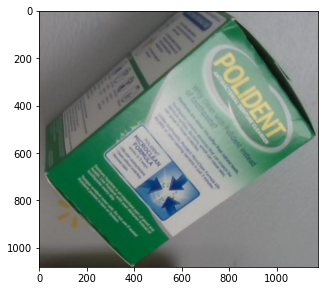

1015803449-Cleanser :   predicted as  1015803449-Cleanser 0.999


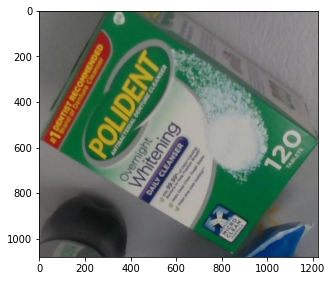

1015803449-Cleanser :   predicted as  1015803449-Cleanser 0.9795


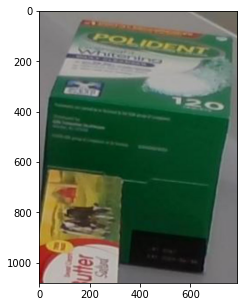

1015803449-Cleanser :   predicted as unrecongized -  7874212406-sweetner 0.2942


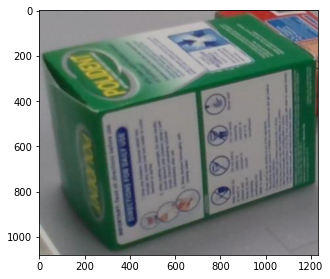

1015803449-Cleanser :   predicted as unrecongized -  8113118392-tussin 0.726

accuracy on class 1015803449-Cleanser is :0.875

recongized:  8    unrecognized:  4


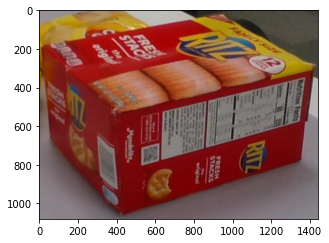

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 0.835


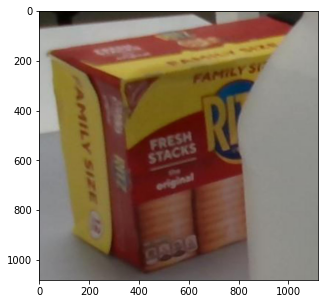

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


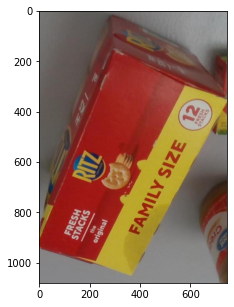

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 0.9995


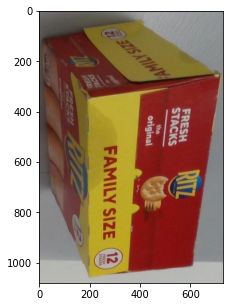

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


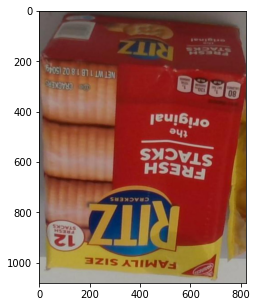

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 0.9995


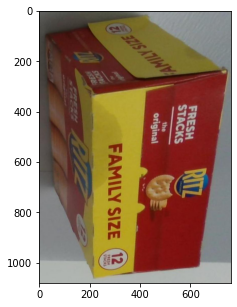

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


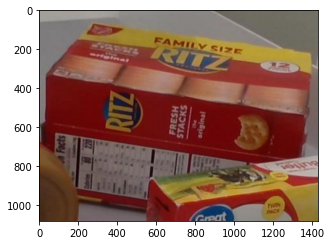

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


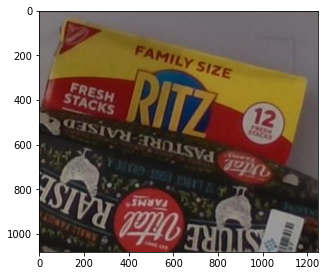

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


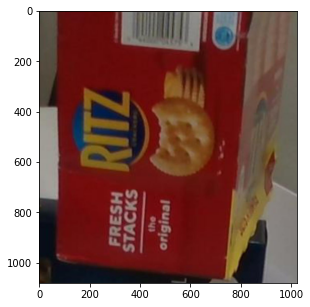

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


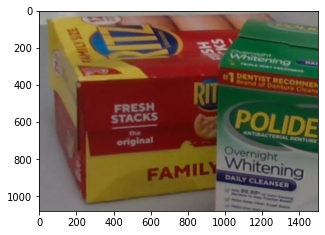

4400004575-RitzCracker :   predicted as unrecongized -  1015803449-Cleanser 0.5566


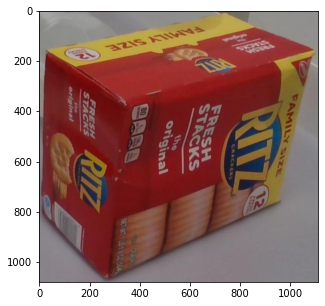

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


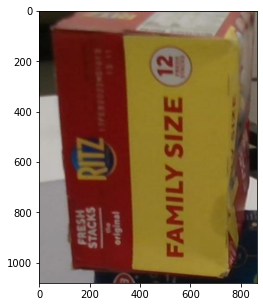

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 1.0


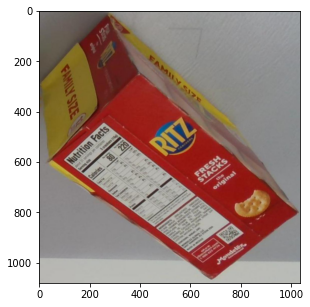

4400004575-RitzCracker :   predicted as  4400004575-RitzCracker 0.996


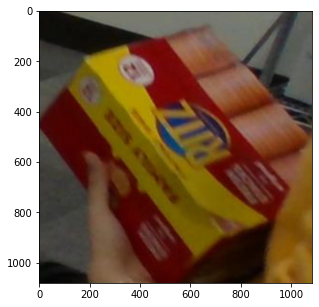

4400004575-RitzCracker :   predicted as unrecongized -  4400004575-RitzCracker 0.7085

accuracy on class 4400004575-RitzCracker is :1.0

recongized:  12    unrecognized:  2


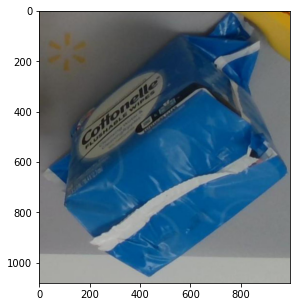

3600041777-Wipes :   predicted as  3600041777-Wipes 0.8667


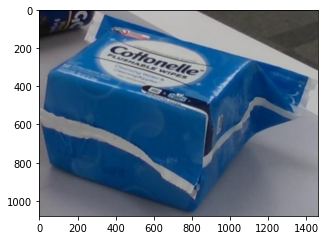

3600041777-Wipes :   predicted as  3600041777-Wipes 0.799


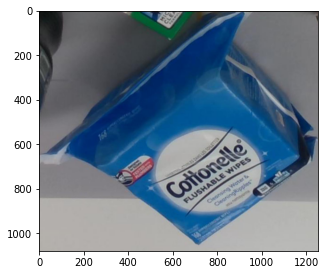

3600041777-Wipes :   predicted as  3600041777-Wipes 0.986


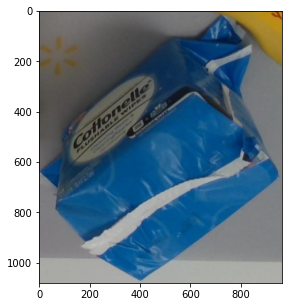

3600041777-Wipes :   predicted as  3600041777-Wipes 0.877


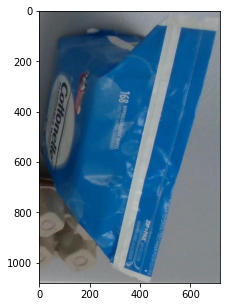

3600041777-Wipes :   predicted as  1800012323-miniBiscuits 0.804


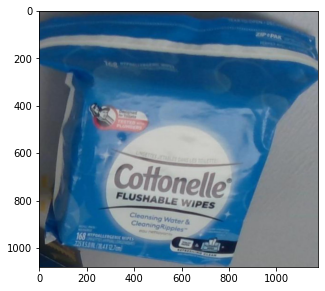

3600041777-Wipes :   predicted as  3600041777-Wipes 1.0


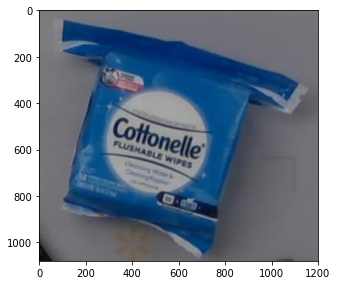

3600041777-Wipes :   predicted as  3600041777-Wipes 1.0


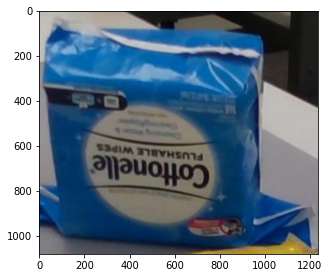

3600041777-Wipes :   predicted as unrecongized -  1800012323-miniBiscuits 0.3623


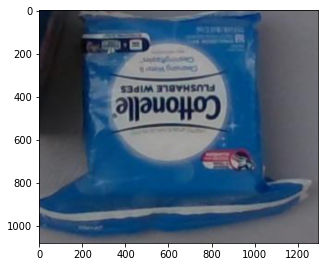

3600041777-Wipes :   predicted as unrecongized -  3600041777-Wipes 0.4548


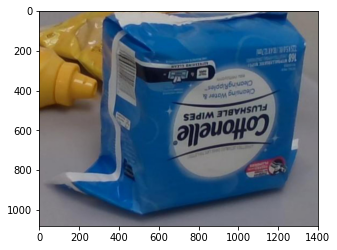

3600041777-Wipes :   predicted as unrecongized -  1800012323-miniBiscuits 0.4785

accuracy on class 3600041777-Wipes is :0.8571428571428571

recongized:  7    unrecognized:  3


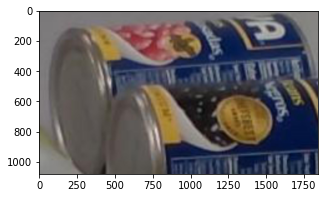

41331112406-Beans :   predicted as unrecongized -  5000015991-evaporatedMilk 0.3518


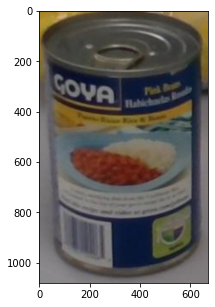

41331112406-Beans :   predicted as  41331112406-Beans 0.9995


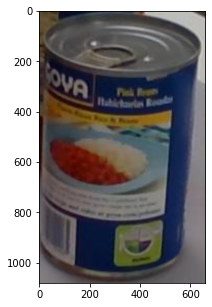

41331112406-Beans :   predicted as  41331112406-Beans 0.986


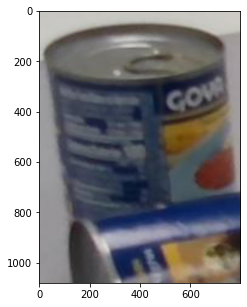

41331112406-Beans :   predicted as  41331112406-Beans 0.911


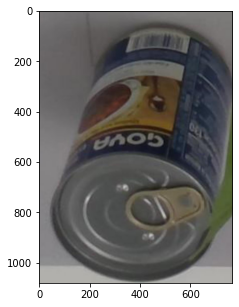

41331112406-Beans :   predicted as unrecongized -  4288742634-dishwasherCleaner 0.366


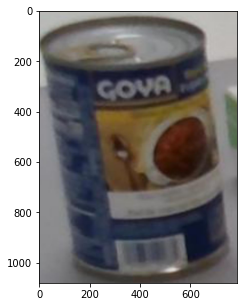

41331112406-Beans :   predicted as  41331112406-Beans 0.999


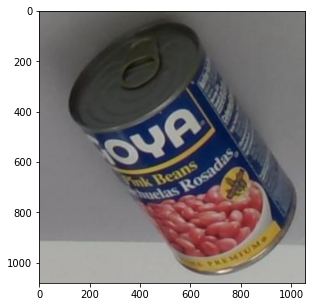

41331112406-Beans :   predicted as  41331112406-Beans 1.0


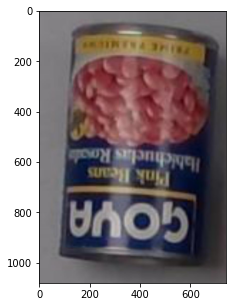

41331112406-Beans :   predicted as  41331112406-Beans 0.9688


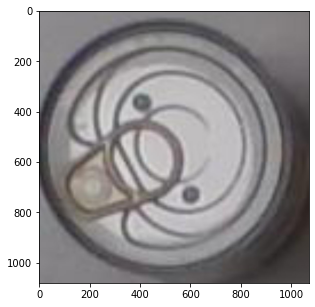

41331112406-Beans :   predicted as  4288742634-dishwasherCleaner 0.9487


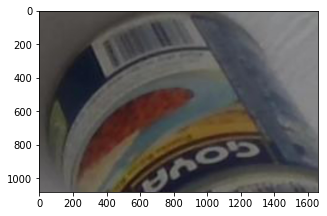

41331112406-Beans :   predicted as unrecongized -  4400004575-RitzCracker 0.1693


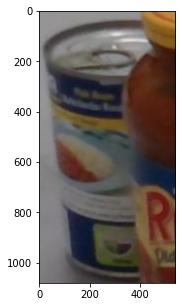

41331112406-Beans :   predicted as unrecongized -  4288742634-dishwasherCleaner 0.283

accuracy on class 41331112406-Beans is :0.8571428571428571

recongized:  7    unrecognized:  4


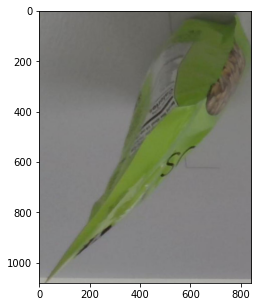

1411391254-Pistachios :   predicted as unrecongized -  84576204143-galaApple 0.588


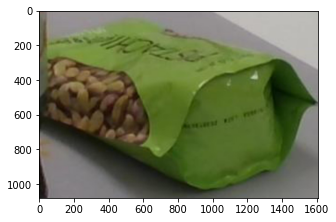

1411391254-Pistachios :   predicted as unrecongized -  1411391254-Pistachios 0.6357


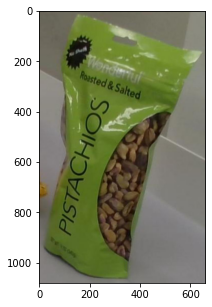

1411391254-Pistachios :   predicted as  1411391254-Pistachios 1.0


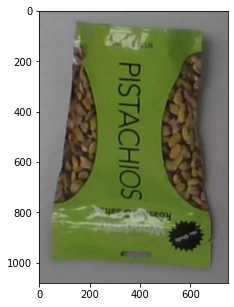

1411391254-Pistachios :   predicted as  1411391254-Pistachios 1.0


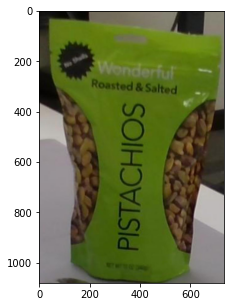

1411391254-Pistachios :   predicted as  1411391254-Pistachios 1.0


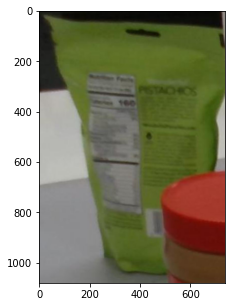

1411391254-Pistachios :   predicted as unrecongized -  1411391254-Pistachios 0.719


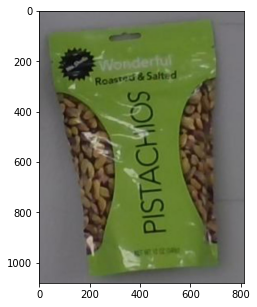

1411391254-Pistachios :   predicted as  1411391254-Pistachios 1.0


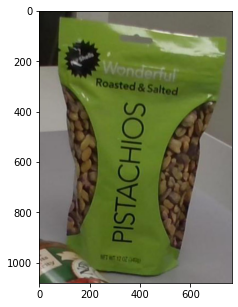

1411391254-Pistachios :   predicted as  1411391254-Pistachios 1.0


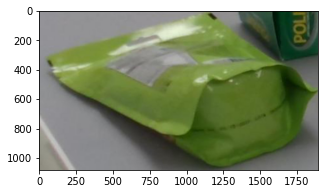

1411391254-Pistachios :   predicted as unrecongized -  4300020056-limeJello 0.642


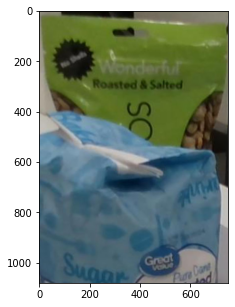

1411391254-Pistachios :   predicted as unrecongized -  1411391254-Pistachios 0.6685


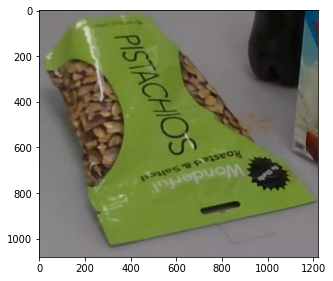

1411391254-Pistachios :   predicted as  1411391254-Pistachios 0.999


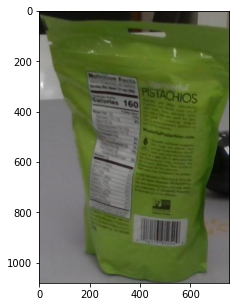

1411391254-Pistachios :   predicted as  1411391254-Pistachios 0.903


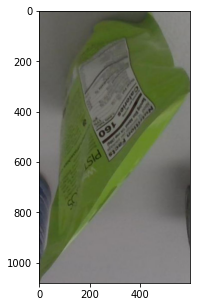

1411391254-Pistachios :   predicted as unrecongized -  5000015991-evaporatedMilk 0.4187

accuracy on class 1411391254-Pistachios is :1.0

recongized:  7    unrecognized:  6

no picture are found for 8616220043-water

no picture are found for 7203002209-littleBite

no picture are found for 4000055113-m&mMilk

no picture are found for 1800012323-miniBiscuits

no picture are found for 4000051121-m&mPeanut

no picture are found for 3528244925-toyPenguin

no picture are found for 1920089962-SurfaceCleaner

no picture are found for 1600017819-berryCereal

no picture are found for 5000015991-evaporatedMilk

no picture are found for 7314115315-oreoPocky

no picture are found for 7232075003-pandaCookie

no picture are found for 787423717-taco

no picture are found for 4300020056-limeJello

no picture are found for 4300020053-cherryJello

no picture are found for 1370037299-Ziplock

no picture are found for 4288742634-dishwasherCleaner

no picture are found for 000000-lemon

no picture are found

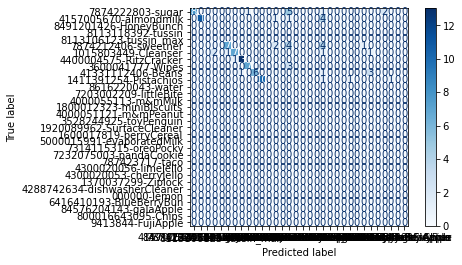

In [37]:
# Enroll new product{class:description}
product_descriptions = {"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mMilk":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanut": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk"}

print(list(product_descriptions.keys()))
print(list(product_descriptions.values()))

%matplotlib inline

import torch
import clip
from PIL import Image
import glob
import matplotlib.pyplot as plt

def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/16", device=device)

correct = []

#define our target classificaitons, you can should experiment with these strings of text as you see fit, though, make sure they are in the same order as your class names above
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)
y_true = []
y_pred = []
fp_sum = 0
counter_sum = 0
for cls in class_names:
    class_correct = []
    unrecognized_sum = 0
    counter_sum += 1
    test_imgs = glob.glob('./sb_22samples_fit/valid/' + cls + '/*.jpg')

    for img in test_imgs:
        image = transform(Image.open(img)).unsqueeze(0).to(device)
        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)

            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()
            #print("probs: ",probs)
            max_index = argmax(list(probs)[0])
            pred = class_names[max_index]
            max_score = probs[0][max_index]                   
            im = Image.open(img)
            plt.figure(figsize=(5,5))
            plt.imshow(im)
            plt.show()
            #max_score = max(list(prob))
            #print(cls, ": "," predicted as ", pred, max_score )
            
            if max_score > 0.78:
                print(cls, ": "," predicted as ", pred, max_score )
                if pred == cls:
                    correct.append(1)
                    class_correct.append(1)
                else:
                    correct.append(0)
                    class_correct.append(0)
                    fp_sum += 1
            else:
                print(cls, ": "," predicted as unrecongized - ", pred, max_score)
                unrecognized_sum += 1
                
            y_true.append(cls)
            y_pred.append(pred)
    
    if len(class_correct) !=0:
        print('\naccuracy on class ' + cls + ' is :' + str(sum(class_correct)/len(class_correct)))
        print('\nrecongized: ', len(class_correct) , '   unrecognized: ', unrecognized_sum )
    else: 
        print('\nno picture are found for ' + cls)
print('\naccuracy on all is : ' + str(sum(correct)/len(correct)))
print('counter_sum: ', counter_sum, '  fp_sum:',fp_sum)
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_true, y_pred, labels = class_names)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.show()

['7874222803-sugar', '4157005670-almondmilk', '8491201426-HoneyBunch', '8113118392-tussin', '8113106123-tussin_max', '7874212406-sweetner', '1015803449-Cleanser', '4400004575-RitzCracker', '3600041777-Wipes', '41331112406-Beans', '1411391254-Pistachios', '8616220043-water', '7203002209-littleBite', '4000055113-m&mMilk', '1800012323-miniBiscuits', '4000051121-m&mPeanut', '3528244925-toyPenguin', '1920089962-SurfaceCleaner', '1600017819-berryCereal', '5000015991-evaporatedMilk', '7314115315-oreoPocky', '7232075003-pandaCookie', '787423717-taco', '4300020056-limeJello', '4300020053-cherryJello', '1370037299-Ziplock', '4288742634-dishwasherCleaner', '000000-lemon', '6416410193-BlueBerryBun', '84576204143-galaApple', '800016643095-Chips', '9413844-FujiApple']
['Great Value Pure Granulated Sugar 4 lb', 'Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz', 'Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce', '

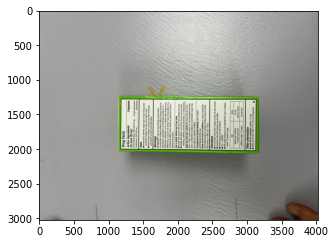

8113118392-tussin :   predicted as  5000015991-evaporatedMilk 0.298


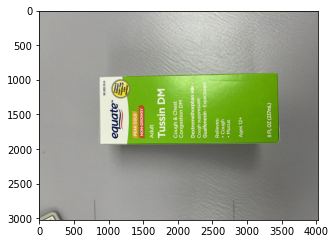

8113118392-tussin :   predicted as  7874212406-sweetner 0.4143


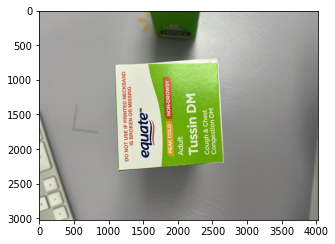

8113118392-tussin :   predicted as  8113106123-tussin_max 0.632

accuracy on class 8113118392-tussin is :0.0


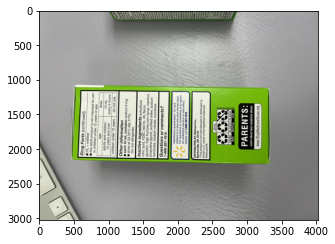

8113106123-tussin_max :   predicted as  5000015991-evaporatedMilk 0.3352


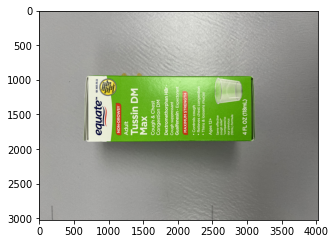

8113106123-tussin_max :   predicted as  8113106123-tussin_max 0.4492


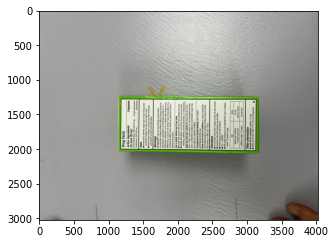

8113106123-tussin_max :   predicted as  5000015991-evaporatedMilk 0.298


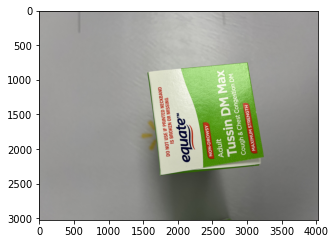

8113106123-tussin_max :   predicted as  8113106123-tussin_max 0.4998

accuracy on class 8113106123-tussin_max is :0.5

no picture are found for 7874212406-sweetner

no picture are found for 1015803449-Cleanser

no picture are found for 4400004575-RitzCracker

no picture are found for 3600041777-Wipes

no picture are found for 41331112406-Beans

no picture are found for 1411391254-Pistachios

no picture are found for 8616220043-water


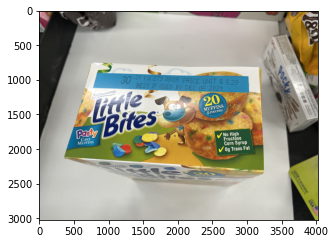

7203002209-littleBite :   predicted as  7203002209-littleBite 0.981


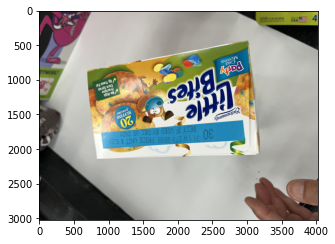

7203002209-littleBite :   predicted as  7203002209-littleBite 0.444


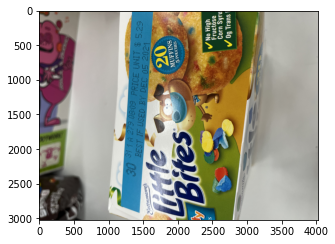

7203002209-littleBite :   predicted as  1800012323-miniBiscuits 0.8584


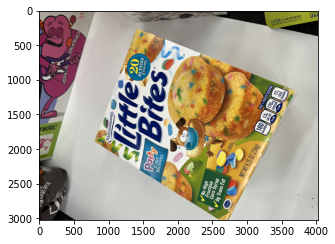

7203002209-littleBite :   predicted as  7203002209-littleBite 0.6187


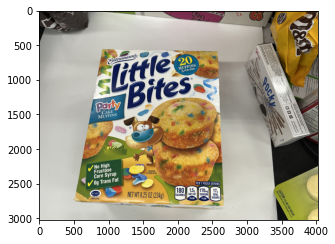

7203002209-littleBite :   predicted as  7203002209-littleBite 0.942


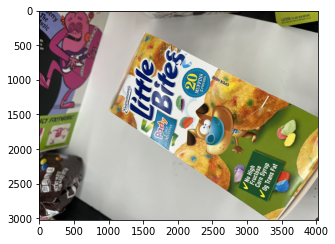

7203002209-littleBite :   predicted as  7203002209-littleBite 0.4941

accuracy on class 7203002209-littleBite is :0.8333333333333334


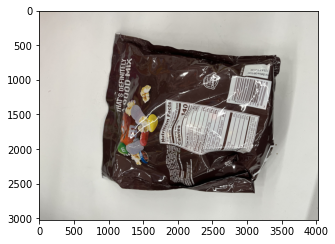

4000055113-m&mMilk :   predicted as  4000055113-m&mMilk 0.479


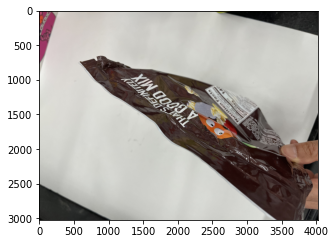

4000055113-m&mMilk :   predicted as  800016643095-Chips 0.6357


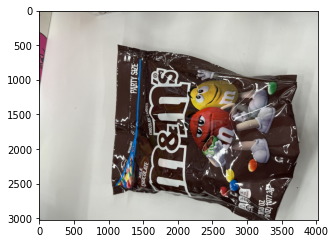

4000055113-m&mMilk :   predicted as  4000055113-m&mMilk 0.8604


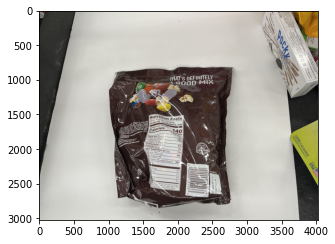

4000055113-m&mMilk :   predicted as  84576204143-galaApple 0.6523


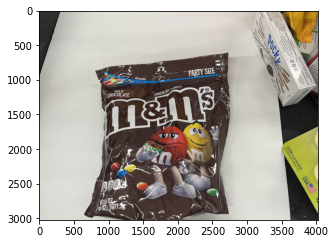

4000055113-m&mMilk :   predicted as  4000055113-m&mMilk 0.938

accuracy on class 4000055113-m&mMilk is :0.6

no picture are found for 1800012323-miniBiscuits


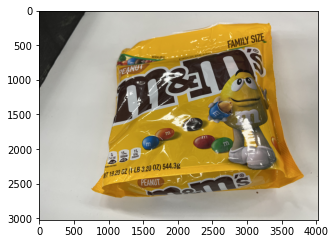

4000051121-m&mPeanut :   predicted as  4000055113-m&mMilk 0.853


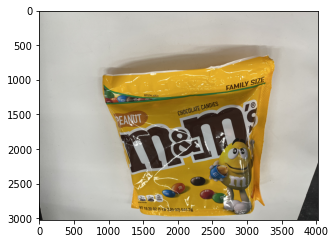

4000051121-m&mPeanut :   predicted as  4000051121-m&mPeanut 0.954


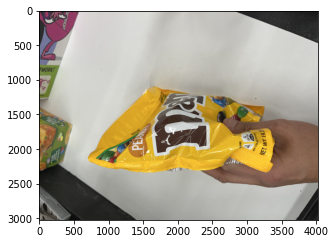

4000051121-m&mPeanut :   predicted as  4000055113-m&mMilk 0.7607


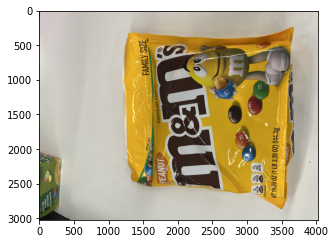

4000051121-m&mPeanut :   predicted as  4000055113-m&mMilk 0.6787


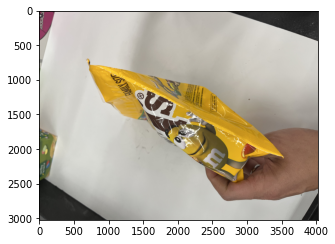

4000051121-m&mPeanut :   predicted as  4000055113-m&mMilk 0.591

accuracy on class 4000051121-m&mPeanut is :0.2


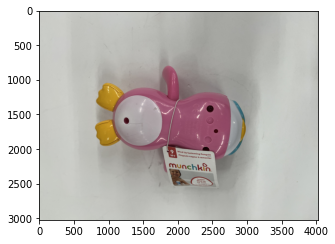

3528244925-toyPenguin :   predicted as  3528244925-toyPenguin 0.9956


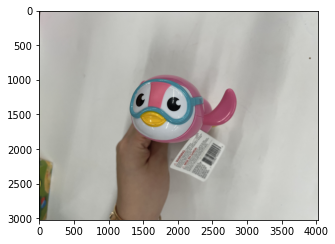

3528244925-toyPenguin :   predicted as  3528244925-toyPenguin 0.9995


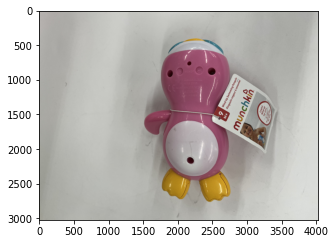

3528244925-toyPenguin :   predicted as  3528244925-toyPenguin 0.9062


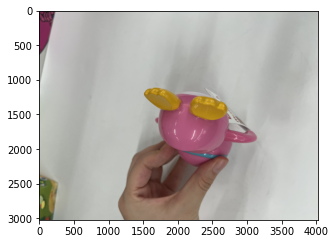

3528244925-toyPenguin :   predicted as  3528244925-toyPenguin 0.9966


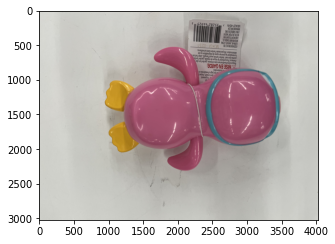

3528244925-toyPenguin :   predicted as  3528244925-toyPenguin 0.9775

accuracy on class 3528244925-toyPenguin is :1.0

no picture are found for 1920089962-SurfaceCleaner

no picture are found for 1600017819-berryCereal

no picture are found for 5000015991-evaporatedMilk


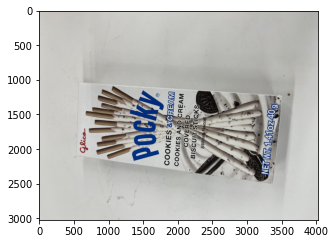

7314115315-oreoPocky :   predicted as  7314115315-oreoPocky 0.991


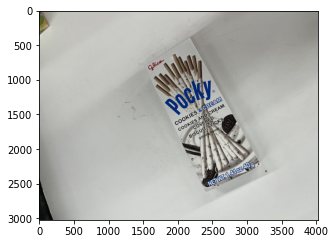

7314115315-oreoPocky :   predicted as  7314115315-oreoPocky 0.976


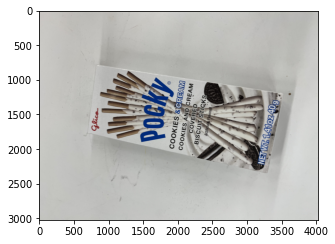

7314115315-oreoPocky :   predicted as  7314115315-oreoPocky 0.9556


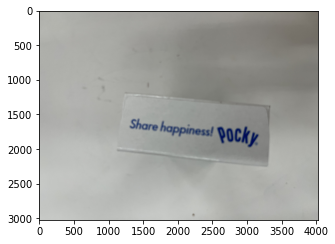

7314115315-oreoPocky :   predicted as  7314115315-oreoPocky 0.6714


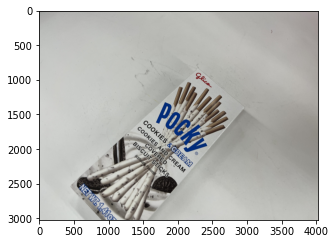

7314115315-oreoPocky :   predicted as  7314115315-oreoPocky 1.0


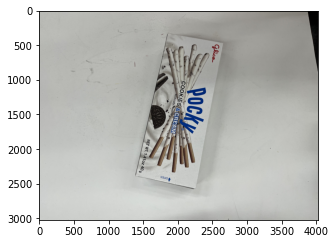

7314115315-oreoPocky :   predicted as  7314115315-oreoPocky 0.7256

accuracy on class 7314115315-oreoPocky is :1.0

no picture are found for 7232075003-pandaCookie

no picture are found for 787423717-taco


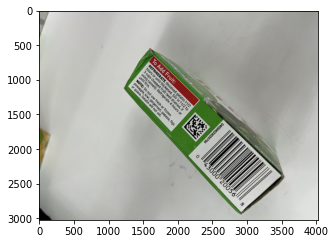

4300020056-limeJello :   predicted as  5000015991-evaporatedMilk 0.668


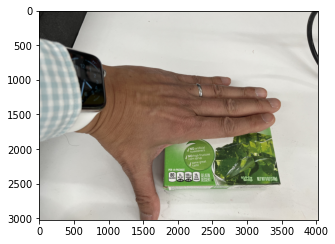

4300020056-limeJello :   predicted as  4288742634-dishwasherCleaner 0.7603


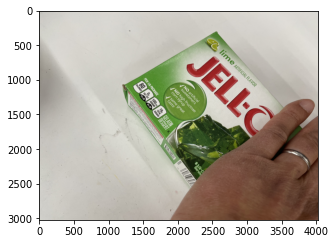

4300020056-limeJello :   predicted as  4300020056-limeJello 0.9673


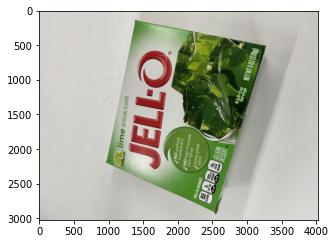

4300020056-limeJello :   predicted as  4300020056-limeJello 0.9346


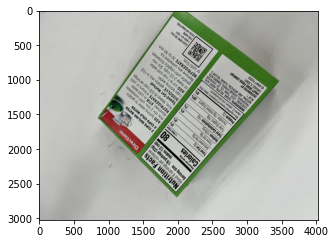

4300020056-limeJello :   predicted as  5000015991-evaporatedMilk 0.1971


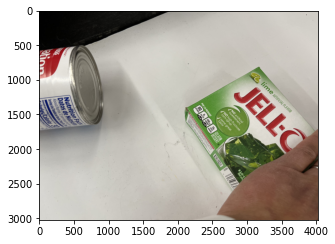

4300020056-limeJello :   predicted as  4300020056-limeJello 0.9644


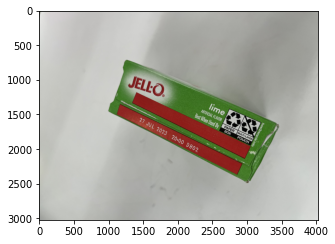

4300020056-limeJello :   predicted as  4300020056-limeJello 0.909


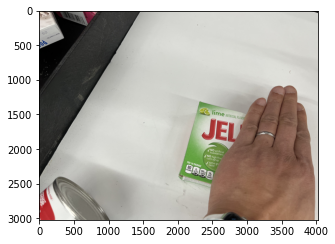

4300020056-limeJello :   predicted as  4300020056-limeJello 0.859


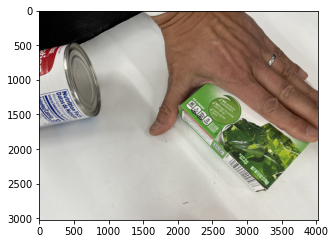

4300020056-limeJello :   predicted as  5000015991-evaporatedMilk 0.3298


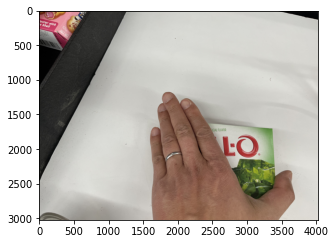

4300020056-limeJello :   predicted as  4300020056-limeJello 0.779


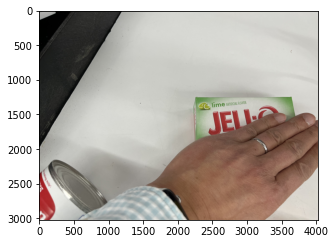

4300020056-limeJello :   predicted as  4300020056-limeJello 0.8726


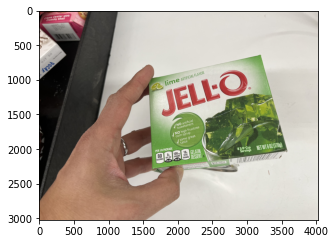

4300020056-limeJello :   predicted as  4300020056-limeJello 0.9756


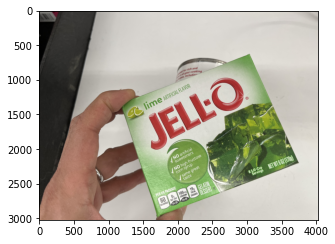

4300020056-limeJello :   predicted as  4300020056-limeJello 0.988


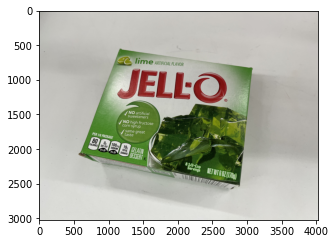

4300020056-limeJello :   predicted as  4300020056-limeJello 0.9917


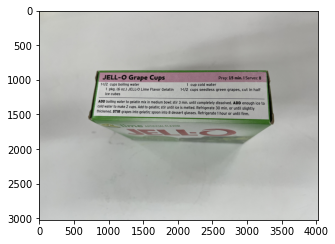

4300020056-limeJello :   predicted as  4300020053-cherryJello 0.3992

accuracy on class 4300020056-limeJello is :0.6666666666666666


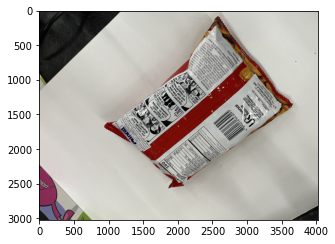

4300020053-cherryJello :   predicted as  4000051121-m&mPeanut 0.2343


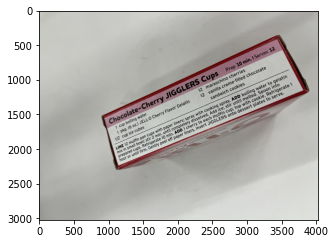

4300020053-cherryJello :   predicted as  7874212406-sweetner 0.392


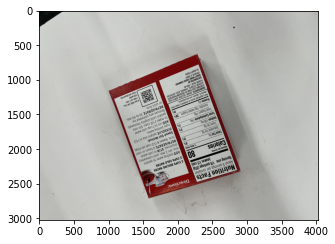

4300020053-cherryJello :   predicted as  5000015991-evaporatedMilk 0.31


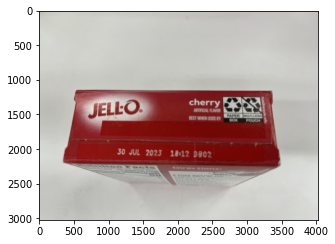

4300020053-cherryJello :   predicted as  4300020053-cherryJello 1.0


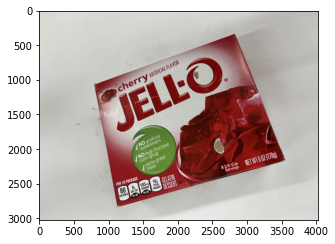

4300020053-cherryJello :   predicted as  4300020053-cherryJello 0.9995


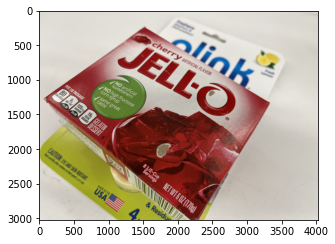

4300020053-cherryJello :   predicted as  4300020053-cherryJello 0.9937


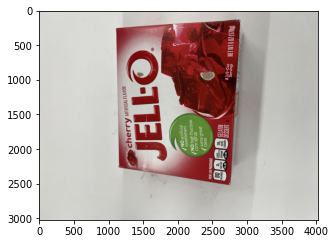

4300020053-cherryJello :   predicted as  4300020053-cherryJello 0.898

accuracy on class 4300020053-cherryJello is :0.5714285714285714


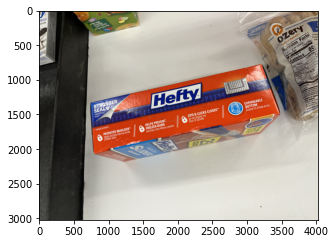

1370037299-Ziplock :   predicted as  1370037299-Ziplock 0.9976


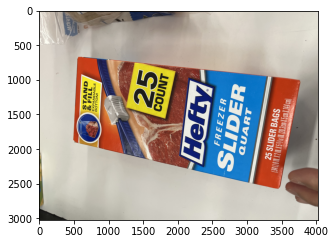

1370037299-Ziplock :   predicted as  1370037299-Ziplock 0.394


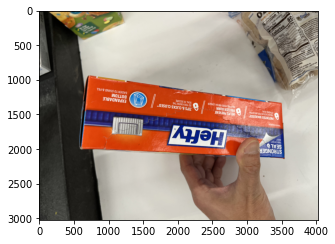

1370037299-Ziplock :   predicted as  7874222803-sugar 0.44


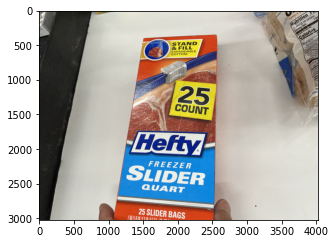

1370037299-Ziplock :   predicted as  1370037299-Ziplock 0.9995


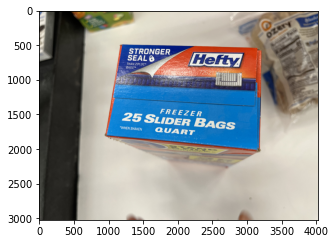

1370037299-Ziplock :   predicted as  1370037299-Ziplock 1.0


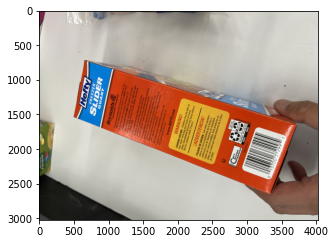

1370037299-Ziplock :   predicted as  1370037299-Ziplock 0.279

accuracy on class 1370037299-Ziplock is :0.8333333333333334


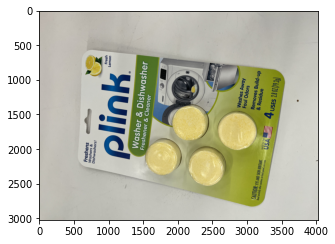

4288742634-dishwasherCleaner :   predicted as  4288742634-dishwasherCleaner 1.0


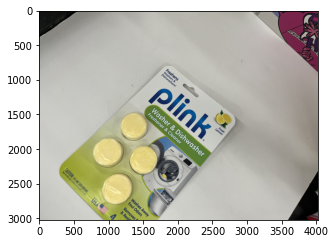

4288742634-dishwasherCleaner :   predicted as  4288742634-dishwasherCleaner 0.998


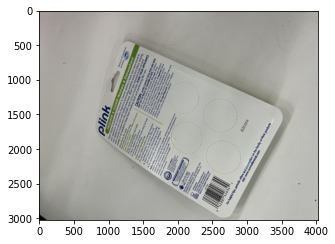

4288742634-dishwasherCleaner :   predicted as  3600041777-Wipes 0.738


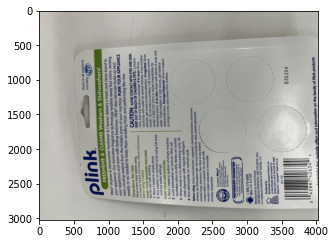

4288742634-dishwasherCleaner :   predicted as  4288742634-dishwasherCleaner 0.6284

accuracy on class 4288742634-dishwasherCleaner is :0.75

no picture are found for 000000-lemon


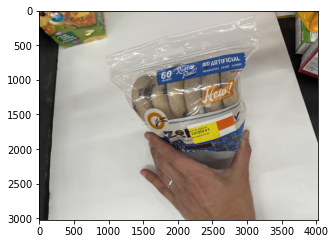

6416410193-BlueBerryBun :   predicted as  1800012323-miniBiscuits 0.42


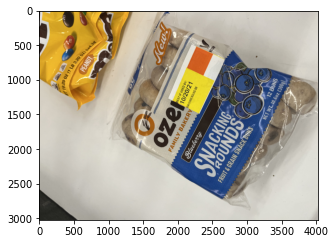

6416410193-BlueBerryBun :   predicted as  6416410193-BlueBerryBun 0.6143


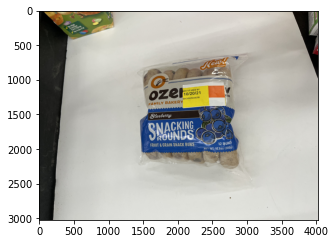

6416410193-BlueBerryBun :   predicted as  6416410193-BlueBerryBun 0.912


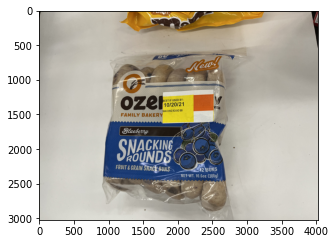

6416410193-BlueBerryBun :   predicted as  6416410193-BlueBerryBun 0.992


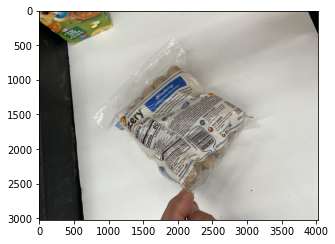

6416410193-BlueBerryBun :   predicted as  1800012323-miniBiscuits 0.528

accuracy on class 6416410193-BlueBerryBun is :0.6


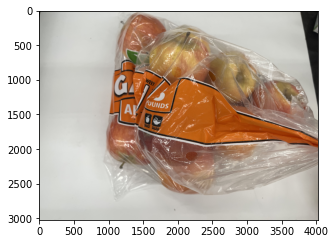

84576204143-galaApple :   predicted as  84576204143-galaApple 0.9023


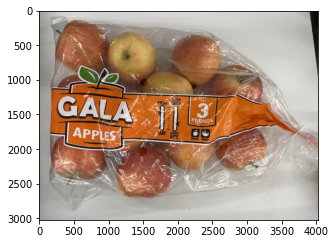

84576204143-galaApple :   predicted as  84576204143-galaApple 0.9766


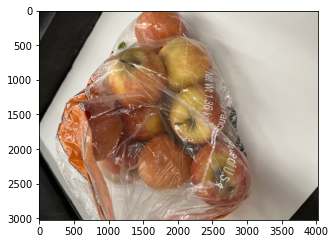

84576204143-galaApple :   predicted as  84576204143-galaApple 0.737


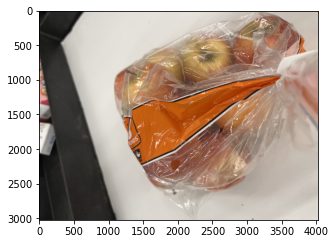

84576204143-galaApple :   predicted as  84576204143-galaApple 0.909


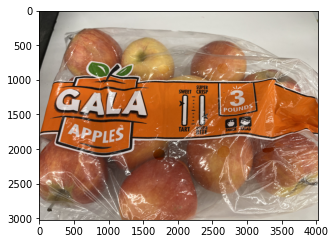

84576204143-galaApple :   predicted as  84576204143-galaApple 0.9883


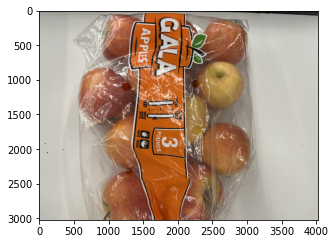

84576204143-galaApple :   predicted as  84576204143-galaApple 0.698


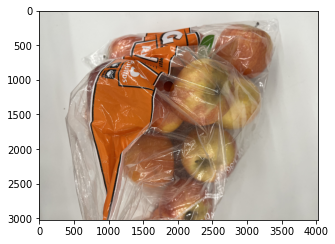

84576204143-galaApple :   predicted as  84576204143-galaApple 0.9194

accuracy on class 84576204143-galaApple is :1.0


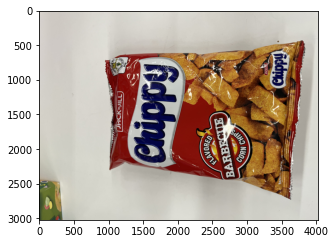

800016643095-Chips :   predicted as  84576204143-galaApple 0.278


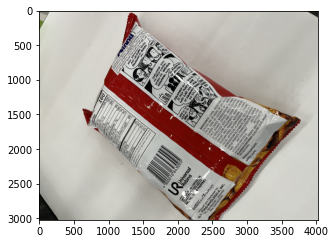

800016643095-Chips :   predicted as  800016643095-Chips 0.655


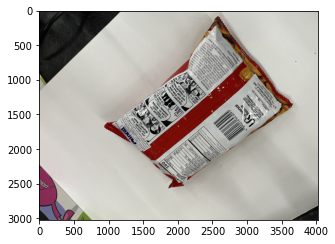

800016643095-Chips :   predicted as  4000051121-m&mPeanut 0.2343


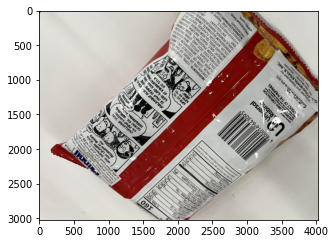

800016643095-Chips :   predicted as  800016643095-Chips 0.1936


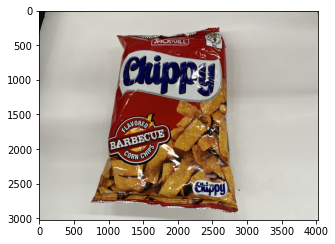

800016643095-Chips :   predicted as  800016643095-Chips 0.628


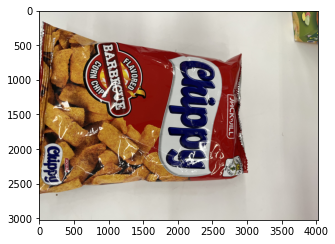

800016643095-Chips :   predicted as  800016643095-Chips 0.3179

accuracy on class 800016643095-Chips is :0.6666666666666666


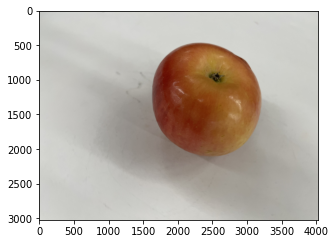

9413844-FujiApple :   predicted as  9413844-FujiApple 0.685


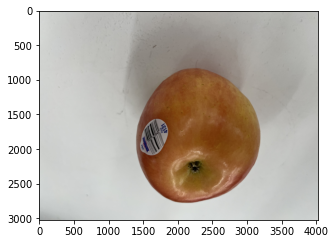

9413844-FujiApple :   predicted as  84576204143-galaApple 0.533


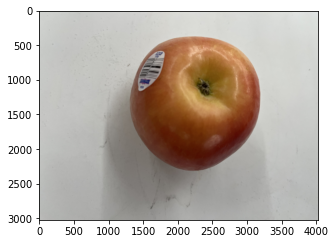

9413844-FujiApple :   predicted as  84576204143-galaApple 0.658


KeyboardInterrupt: 

In [20]:
# Enroll new product{class:description}
product_descriptions = {"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mMilk":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanut": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk"}

print(list(product_descriptions.keys()))
print(list(product_descriptions.values()))

%matplotlib inline

import torch
import clip
from PIL import Image
import glob
import matplotlib.pyplot as plt

def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/32", device=device)

correct = []

#define our target classificaitons, you can should experiment with these strings of text as you see fit, though, make sure they are in the same order as your class names above
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)
y_true = []
y_pred = []
for cls in class_names:
    class_correct = []
    test_imgs = glob.glob('./store2280_sample/' + cls + '/*.jpeg')

    for img in test_imgs:
        image = transform(Image.open(img)).unsqueeze(0).to(device)
        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)

            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            pred = class_names[argmax(list(probs)[0])]
            im = Image.open(img)
            plt.figure(figsize=(5,5))
            plt.imshow(im)
            plt.show()

            print(cls, ": "," predicted as ", pred, max(list(probs)[0]) )
            if pred == cls:
                correct.append(1)
                class_correct.append(1)
            else:
                correct.append(0)
                class_correct.append(0)
            y_true.append(cls)
            y_pred.append(pred)
    
    if len(class_correct) !=0:
        print('\naccuracy on class ' + cls + ' is :' + str(sum(class_correct)/len(class_correct)))
    else: 
        print('\nno picture are found for ' + cls)
print('\naccuracy on all is : ' + str(sum(correct)/len(correct)))
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_true, y_pred, labels = class_names)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [23]:
len(class_correct)

0

# Run with Realsense D435i Streaming

### 1. Tried custom text embedding

In [48]:
# Check available model
clip.available_models()

['RN50', 'RN101', 'RN50x4', 'RN50x16', 'ViT-B/32', 'ViT-B/16']

### 2. Tried Walmart product name from catalogue item file for text embebdding

In [ ]:
import pyrealsense2 as rs
import cv2
import numpy as np
import torch
import clip
from PIL import Image

# upload a clip model

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/32", device=device)

# Enroll new product {upc: walmart product name}
product_descriptions = {"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mmilkchocolate":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanutChoco": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk"}




#define our target classificaitons
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)


def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

try:
    pipeline = rs.pipeline()
    config = rs.config()
    config.enable_stream(rs.stream.color, 640,480, rs.format.bgr8, 30)
    pipeline.start(config)
    
    while True:
        frames = pipeline.wait_for_frames()    
        color_image = np.asarray(frames.get_color_frame().get_data())
        
        img = Image.fromarray(color_image)

        image = transform(img).unsqueeze(0).to(device)   # transform takes PIL image only - See clip.py

        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)
            
            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            pred = class_names[argmax(list(probs)[0])]
            prob = max(list(probs)[0])
            if prob > 0.60:
                class_str = pred + ' ' + str(prob)
            else:
                class_str = "Not recognized"
            
        cv2.namedWindow("Classifier", cv2.WINDOW_NORMAL)
        cv2.resizeWindow("Classifier", 1280, 960)
        cv2.putText(color_image, class_str, (10,25),cv2.FONT_HERSHEY_SIMPLEX,1, (0,0,255),2)

        cv2.imshow("Classifier",color_image)
        cv2.waitKey(1)
    exit(0)
except Exception as e:
    print(e)
    pass